# Predicting Quantum State Propagation Through Time

In this example, we will predict the time evolution of quantum states given a particular initial wavefunction $\psi(\vec x, 0)$ and the governing Hamiltonian $\hat H$. We will do so by using an ESN to predict the solutions of the time-dependent Schrodinger Equation $$i\hbar \frac{\partial }{\partial t} \psi(\vec x, t) = \hat H\psi (\vec x, t)$$ which governs the evolution of the wavefunction of a non-relativistic quantum system.

# Example PDE

## Definition
We will define our Hamiltonian $\hat H$ as follows $$\hat H = \hat T + \hat V = -\frac12 \nabla^2 + V(\vec x)$$ i.e. a time-independent Hamiltonian in 3D.
We will approximate the time evolution operator over a small interval of time as $$\psi(t + \delta t) \approx e^{-i\hat H \delta t}\psi(t) \approx e^{-\hat V\delta t /2}e^{-i\hat T \delta t}e^{-i\hat V \delta t/2}\psi(t)$$ Our starting wavefunction $\psi(\vec x, 0)$ will be a Gaussian wave packet ($\sigma = 1$)
$$\psi(\vec x, 0) = e^{-\frac{|{\vec x}|}{2\sigma^2}}$$

## Split Operator Fourier Method
We'll use the split operator method to solve the PDE. This will involve using position space for the potential energy component, and momentum space (with FFTs) for the kinetic component.

In [ ]:
import numpy as np

def solve_tdse(t=100):
    # Grid Definitions
    L = 20.0
    N = 128
    dx = L / N
    x = np.linspace(-L/2, L/2, N, endpoint=False)
    X, Y, Z = np.meshgrid(x, x, x, indexing='ij')

    # FFT frequencies for momentum grid (kinetic component)
    kx = np.fft.fftfreq(N, d=dx) * 2 * np.pi
    KX, KY, KZ = np.meshgrid(kx, kx, kx, indexing='ij')
    K2 = KX**2 + KY**2 + KZ**2

    # psi_0 : Gaussian wave packet with some momentum
    sigma = 1.0
    k0 = 1.0 
    psi = np.exp(-(X**2 + Y**2 + Z**2) / (2 * sigma**2)) * np.exp(1j * k0 * X)
    psi /= np.linalg.norm(psi)

    # Potential
    omega = 1.0
    V = 0.5 * omega**2 * (X**2 + Y**2 + Z**2)

    # Time parameters
    dt = 0.01
    n_steps = t

    # Precompute evolution operators
    V_half = np.exp(-0.5j * V * dt)
    T_full = np.exp(-0.5j * K2 * dt) 

    # Wavefunctions 
    wavefunctions = np.zeros(shape=(n_steps, *psi.shape), dtype=np.complex64)
    
    # Time evolution loop
    for step in range(n_steps):
        psi = V_half * psi
        psi_k = np.fft.fftn(psi)
        psi_k *= T_full
        psi = np.fft.ifftn(psi_k)
        psi = V_half * psi

        # Normalization
        psi /= np.linalg.norm(psi)

        wavefunctions[step] = psi

    return wavefunctions 

psis = solve_tdse(t=500)

(500, 128, 128, 128)


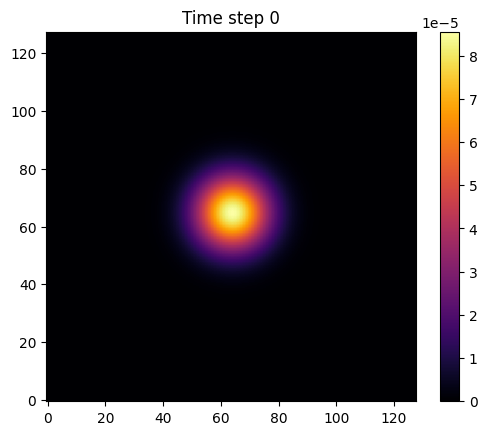

In [5]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import matplotlib as mpl
mpl.rcParams['animation.embed_limit'] = 100

print(psis.shape)
T, N, _, _ = psis.shape
z_index = N // 2

fig, ax = plt.subplots()
initial_density = np.abs(psis[0, :, :, z_index])**2
im = ax.imshow(initial_density, cmap='inferno', origin='lower', vmin=0, vmax=np.max(initial_density))
fig.colorbar(im)
ax.set_title("Time step 0")

def update(frame):
    density = np.abs(psis[frame, :, :, z_index])**2
    im.set_data(density)
    ax.set_title(f"Time step {frame}")
    return [im]

ani = animation.FuncAnimation(
    fig, update, frames=T, interval=50, repeat=False
)
ani.embed_limit = 4000

HTML(ani.to_jshtml())
